In [1]:
import numpy as np
import osmnx as ox
import networkx as nx
import pandas as pd 
import matplotlib.pyplot as plt
import json
%matplotlib inline

In [2]:
''' https://geoffboeing.com/2016/11/osmnx-python-street-networks/
You can also specify several different network types:

drive – get drivable public streets (but not service roads)
drive_service – get drivable public streets, including service roads
walk – get all streets and paths that pedestrians can use (this network type ignores one-way directionality)
bike – get all streets and paths that cyclists can use
all – download all (non-private) OSM streets and paths
all_private – download all OSM streets and paths, including private-access ones
'''

G = ox.graph_from_place("Nicosia,CY", which_result=2, network_type='all')

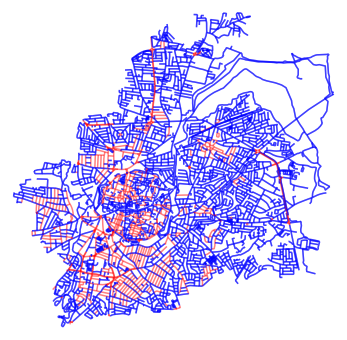

In [3]:
# highlight all the one-way edges
ec = ['red' if data['oneway'] else 'blue' for u, v, key, data in G.edges(keys=True, data=True)]

fig, ax = ox.plot_graph(G, node_size=0, edge_color=ec, edge_linewidth=1.5, edge_alpha=0.5)

In [4]:
# Save graph as svg 
# fig,ax = ox.plot_graph(G, show=True, save=True, filename='nicosia-network', file_format='svg')

In [5]:
nodes, lines = ox.graph_to_gdfs(G)

In [6]:
line = lines['geometry']
point = nodes['geometry'].reset_index(drop=True)

In [7]:
with open('full_data.json', 'r') as f:
    file_data = json.load(f)

In [8]:
# Find the nearest node using get_nearest_node function. This function use Rtree implementation
orig_node_list = []
for key, value in file_data.items():
    for key1, value1 in value.items():
        if key1 == 'geolocation':
            orig_node = ox.get_nearest_node(G, (float(value1.split(',')[0]),float(value1.split(',')[1])),method='euclidean')
#             orig_node = ox.get_nearest_nodes(G, value1.split(',')[0], value1.split(',')[1],method='kdtree')
            orig_node_list.append(orig_node)

In [9]:
# Creating a dataframe with frequency count of nodes 
df = pd.DataFrame(orig_node_list, columns={'node'})
df['freq'] = df.groupby('node')['node'].transform('count')

In [10]:
''' Append new value to my Graph. 
First add default value 0. 
Append new value if the new value is >= than previous. 
'''
for source, target in G.edges():
    G[source][target][0]['road_value'] = 0    
for key, value in df.iterrows():
    for key1, value1 in value.items():
        if key1 == 'node':
            for source, target in G.edges():
                if source == value1 or target == value1:
                    road_value = df.loc[df['node'] == value1,'freq'].iloc[0]                    
                    if road_value>= G[source][target][0]['road_value']:
                        G[source][target][0]['road_value'] = road_value

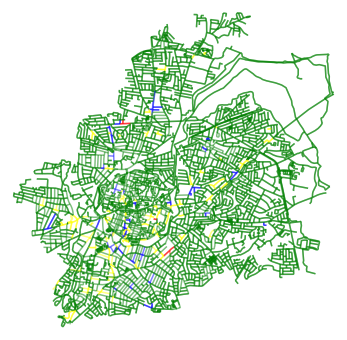

In [11]:
''' Find color for each line.  
Get max node values and divide it by 4. 
'''
ec =[]
max_nodes = df['freq'].max()
for u, v, key, data in G.edges(keys=True, data=True):
    if G[u][v][0]['road_value']/max_nodes <0.25:
        ec.append('green')        
    elif ((G[u][v][0]['road_value']/max_nodes >=0.25) and (G[u][v][0]['road_value']/max_nodes < 0.5)):
        ec.append('yellow')
    elif ((G[u][v][0]['road_value']/max_nodes >=0.5) and (G[u][v][0]['road_value']/max_nodes < 0.75)):
        ec.append('blue')
    else:
        ec.append('red')

fig, ax = ox.plot_graph(G, node_size=0, edge_color=ec, edge_linewidth=1.5, edge_alpha=0.5)

In [12]:
# https://stackoverflow.com/questions/49546015/osmnx-visualize-the-graph-of-edge-centrality-on-folium
gdf_edges = ox.graph_to_gdfs(G,edges=True,
                             nodes=False,
                             fill_edge_geometry=True)
gdf_edges['edge_color'] = ec

from shapely.geometry import LineString, shape, Point

''' 
My coordinates are x,y. This cause a problem to my plot in folium map, because folium take the values as y,x. 
The function swap flip the coordinates to y, x.
https://gis.stackexchange.com/questions/291247/interchange-y-x-to-x-y-with-geopandas-python-or-qgis
'''

def swap(x):
    coords = list(x.coords)
    coords = [Point(t[1], t[0]) for t in coords] #Swap each coordinate using list comprehension and create Points
    return LineString(coords)
gdf_edges.geometry = gdf_edges.geometry.map(swap) 

In [13]:
# Create a list with my edges
# https://gis.stackexchange.com/questions/274313/cannot-access-coords-property-of-linestring-in-geodataframe
edge=[]
for i,j in gdf_edges.iterrows():
    edge.append(list(gdf_edges.geometry.iloc[i].coords))

In [14]:
# Plot my map
import folium
m = folium.Map(location=[35.166667, 33.366667], zoom_start=13, zoom_control=True, tiles='cartodbpositron',
                   control_scale=True)  
for i in range(0,len(edge)):
    for j in range(len(edge[i])):
        folium.PolyLine(locations=edge[i],weight=1,color=gdf_edges.edge_color.iloc[i]).add_to(m)
m